# Running a standard analysis

The analysis is currently split into three plugins: one for pre-processing, one for end-members computation for dimensionality reduction and one for spectral indices computation and display. The plugin is still in experimental phase and subject to interface change, hence the documentation is sitll scarce.

## Pre-processing

In [7]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [12]:
from pathlib import Path
import napari
from napari.utils import nbscreenshot
from napari_sediment.sediment_widget import SedimentWidget

In [9]:
viewer =napari.Viewer()
self = SedimentWidget(viewer)
viewer.window.add_dock_widget(self);

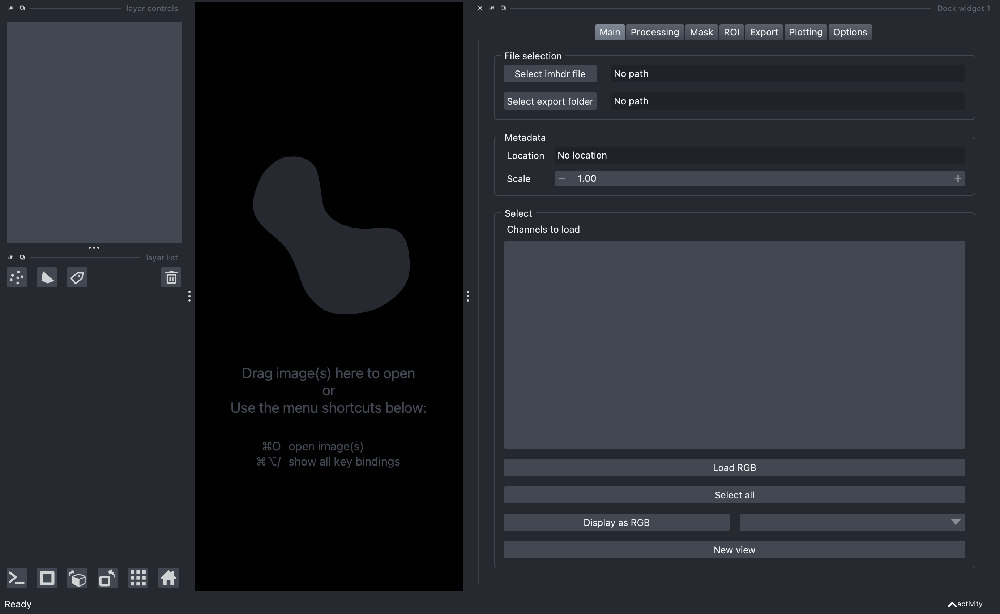

In [10]:
nbscreenshot(viewer)

Above you can see the interface of the pre-processing plugin which is split into multiple parts that we explore here.

### Main

In the main tab, one can set the location of the dataset as well as the place where to save processed data. One can also specify metadata such as acquisition location and pixel scale. Once a dataset has been imported, the channels to be loaded and displayed can be seen in the "Select" part. 

In [13]:
imhdr_path = Path('/Users/gw18g940/Desktop/Test_data/Zahajska/correct_struct/HL_30-40/HL4_30-31_220726-172331/capture/HL4_30-31_220726-172331.hdr')
self.set_paths(imhdr_path)
self._on_select_file()

/Users/gw18g940/mambaforge/envs/spectral20223/lib/python3.10/site-packages/spectral/io/envi.py:175: UserWarning: Parameters with non-lowercase names encountered and converted to lowercase. To retain source file parameter name capitalization, set spectral.settings.envi_support_nonlowercase_params to True.
  warnings.warn(msg)


False

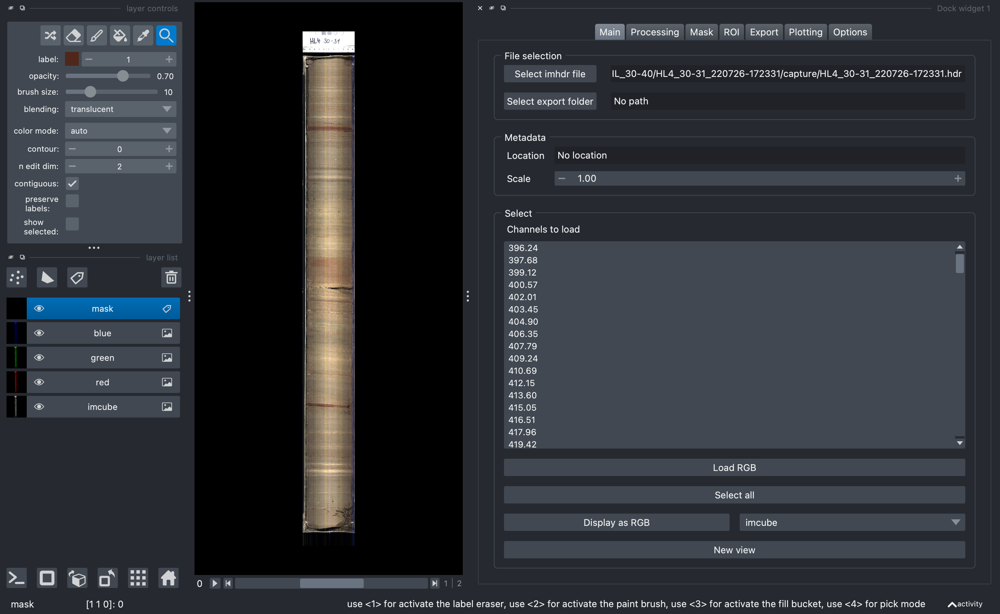

In [14]:
nbscreenshot(viewer)

Above we see the interface once a dataset has been loaded.

## Processing

In the processing tab, one can perform background correction as well as destriping. Note that while background correciton is necessary, desriping ahould not be used for quantitative measures but only to remove striping in plots.

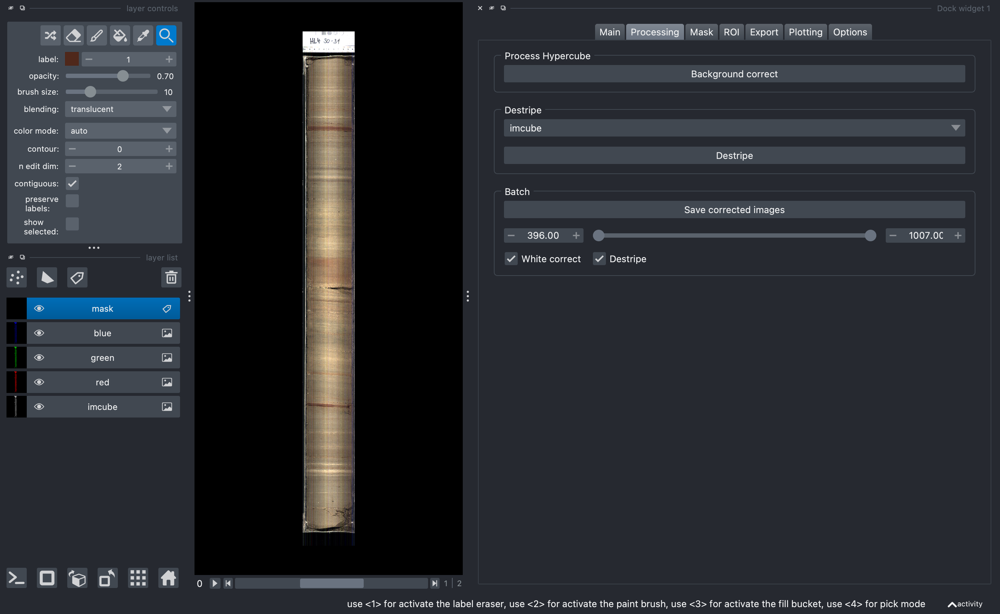

In [15]:
nbscreenshot(viewer)

Correction is time consuming and should be done only for a few bands. After checking that the output is correct, one can perform the correction for all bands (or a subsection). The corrected data are exported as a zarr file which is an efficient data format.

### Mask

Unwanted regions can be annotated in a napari layer. To help with this task, the Mask Tab offers a series of tools: autoamtic border detection, thresholding etc. A pixel classifier also offers the possibility sparsely annotate undesired regions in the image and use that information to find other similar regions.

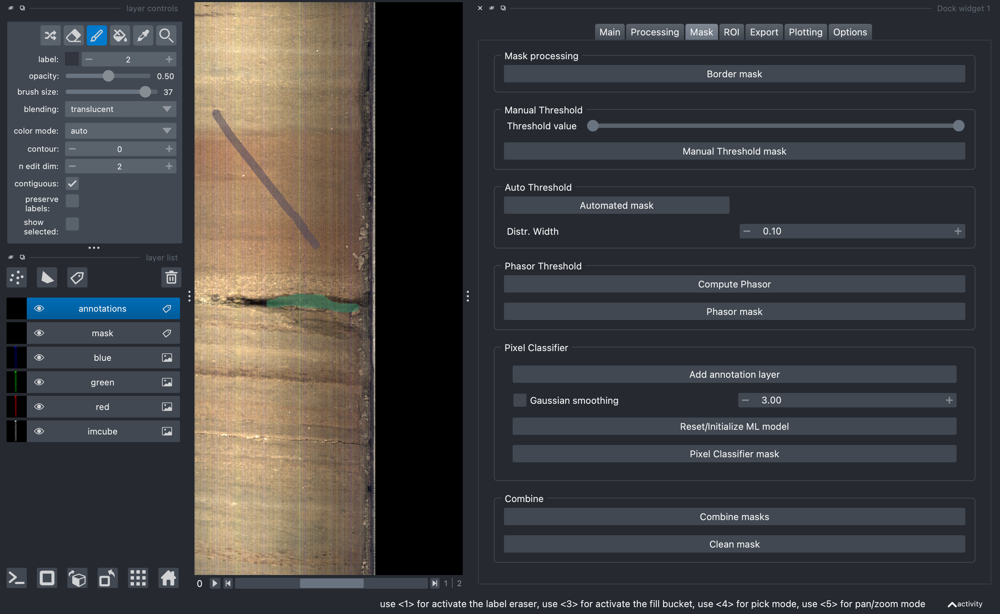

In [16]:
nbscreenshot(viewer)

### ROI

In the ROI tab one can set the regions of interest to analyze. The amin ROI is defined as the largerst box that contains lines which are not all discared.

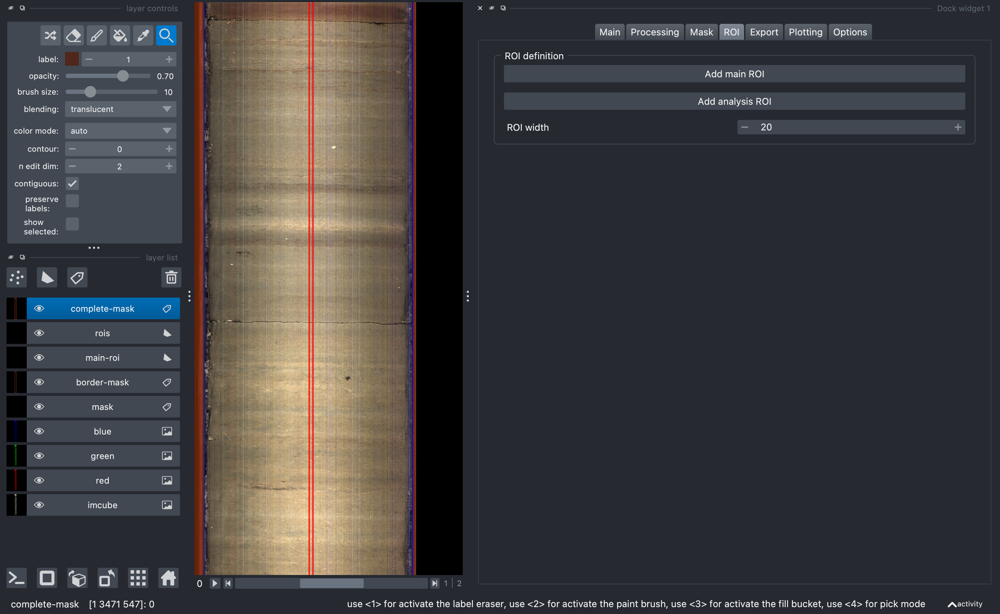

In [17]:
nbscreenshot(viewer)

### Export

In this tab one can export masks, snapshhots, full resolution images as well as *the full project*. Once saved, the project can be reloaded in the plugin.

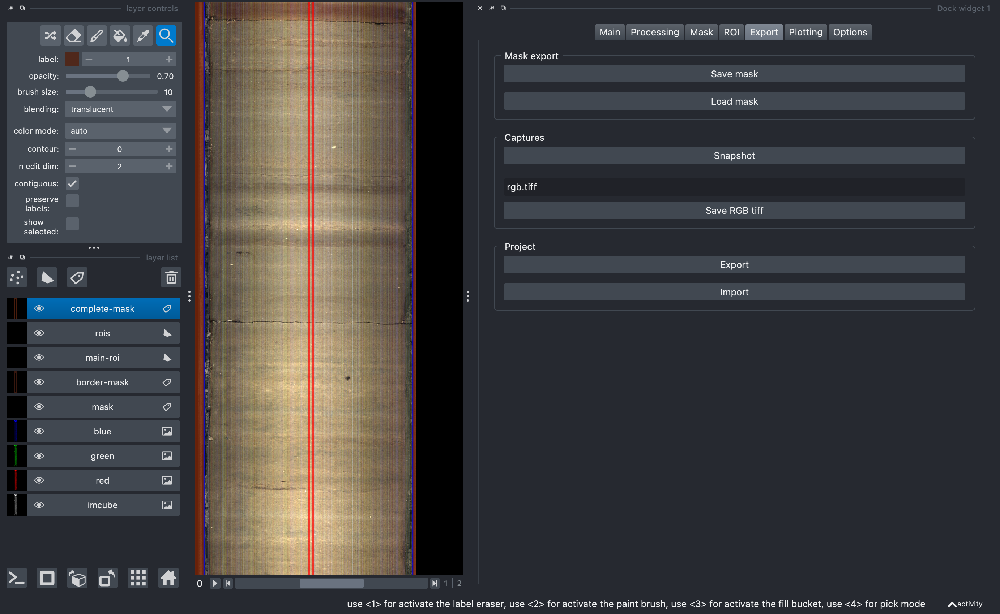

In [18]:
nbscreenshot(viewer)

## Hyperanalysis

In [19]:
from napari_sediment.hyperanalysis_widget import HyperAnalysisWidget

In [21]:
viewer =napari.Viewer()
self = HyperAnalysisWidget(viewer)
viewer.window.add_dock_widget(self);

In [24]:
self.export_folder = Path('/Users/gw18g940/Desktop/test_out/test6/')
self.import_index_project()

RuntimeError: wrapped C/C++ object of type SliderLabel has been deleted

RuntimeError: wrapped C/C++ object of type SliderLabel has been deleted

In the Main tab, one can select again the project exported previously. Only the data subset is loaded and disaplayed. As it is much smaller that the full image, all bands can be loaded at once.

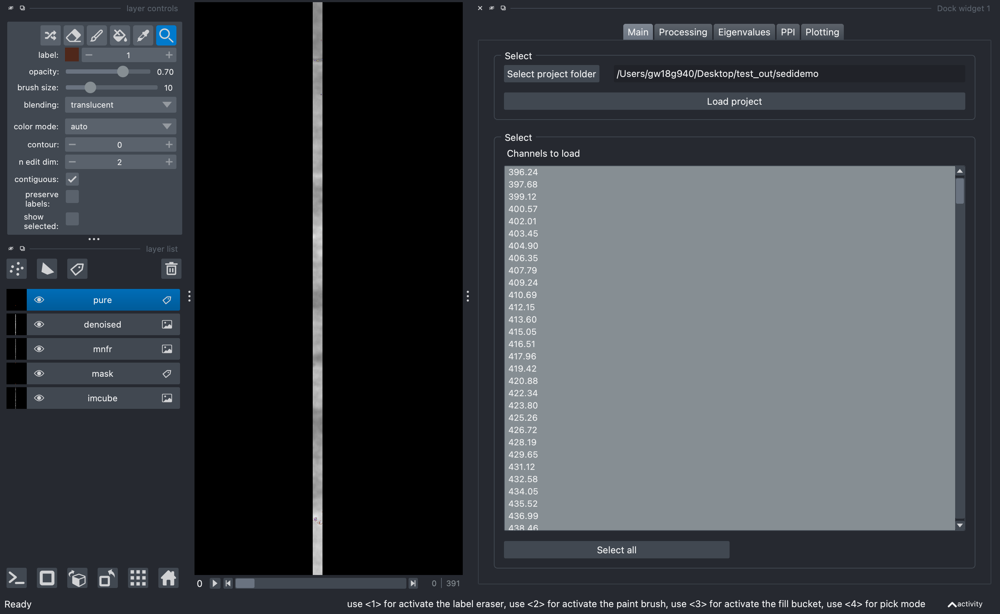

In [25]:
nbscreenshot(viewer)

### Preprocessing

This tab is the center of this plugin: it allows to run the full processing pipeline which generated end-members. The sequence is the following:
1. Compute the minimum noise fraction to retain only meaningfull bands
2. A PCA is applied.
3. Horizonal correlations between rows are computed to identify bands that are not just filled with noise
4. Bands can then be discared based on eigenvalue or correlations by selecting thresholds in the corresponding plots:

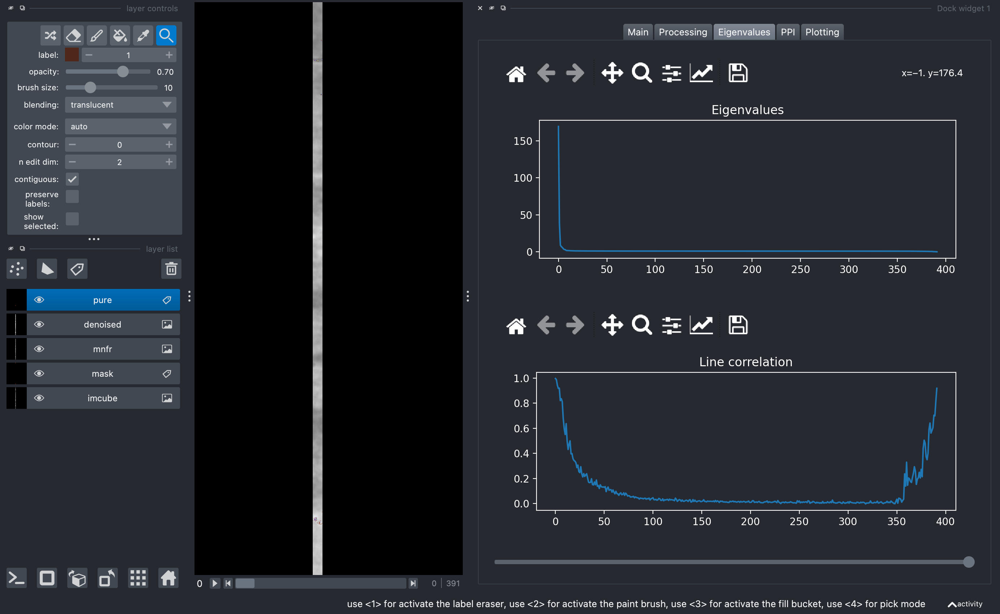

In [26]:
nbscreenshot(viewer)

5. Finally a pixel purity index can be computed. This procedure discovers "interesting" pixels, i.e. pixesl that have the most extreme behaviors
6. Now spectra of pixels can be clustered together and averaged which produces *end-members*.
7. The resulting spectra are shown in the PPI tab.

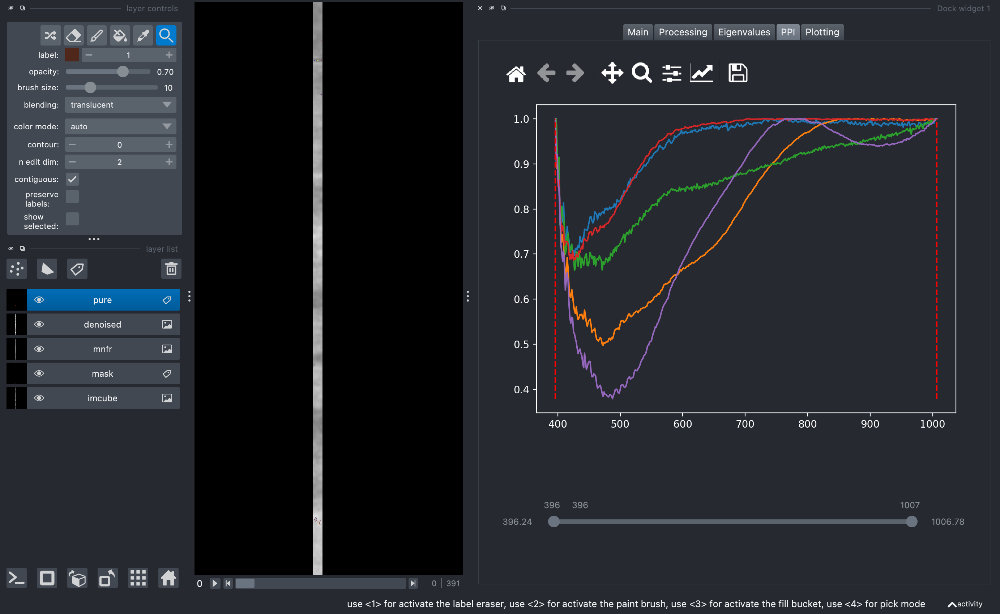

In [27]:
nbscreenshot(viewer)

## Spectral indices

With the end-members we can now finally compute indices in this last plugin:

In [29]:
from napari_sediment.spectral_indices_widget import SpectralIndexWidget
viewer =napari.Viewer()
self = SpectralIndexWidget(viewer)
viewer.window.add_dock_widget(self);

RuntimeError: wrapped C/C++ object of type SliderLabel has been deleted
RuntimeError: wrapped C/C++ object of type SliderLabel has been deleted


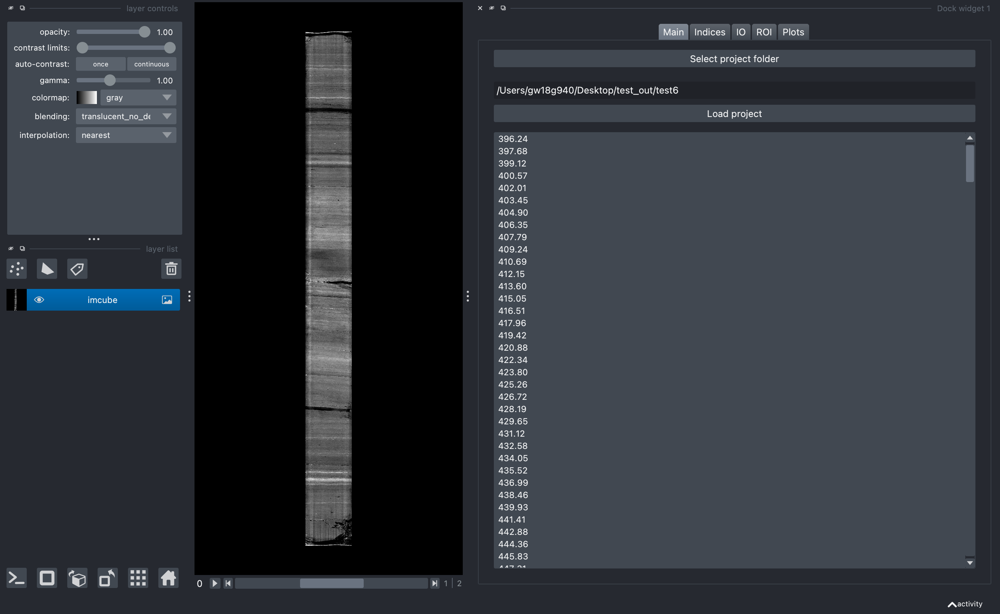

In [30]:
nbscreenshot(viewer)

Again, one needs to select the location of the data. Images are loaded in zarr format so they can be browsed through.

### Indices

In this panel, once can define which index to compute and what points on the spectrum to actually use. This can be done intereactively.

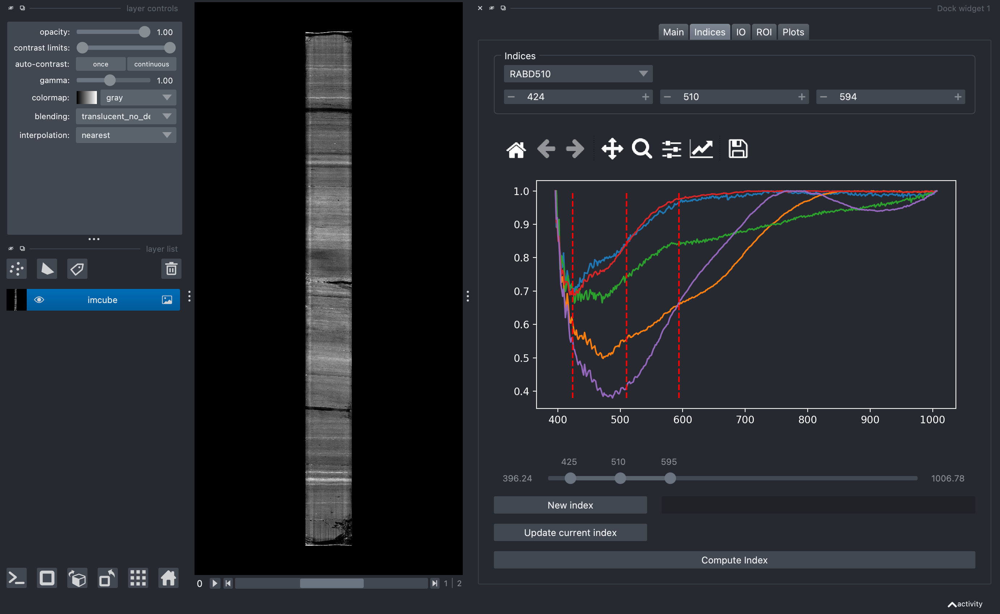

/Users/gw18g940/GoogleDrive/BernMIC/Projects/Spectral/napari-sediment/src/napari_sediment/spectral_indices_widget.py:495: RuntimeWarning: divide by zero encountered in true_divide
  RABD = ((ltr_cube[0] * X_right + ltr_cube[2] * X_left) / (X_left + X_right)) / ltr_cube[1]


In [31]:
nbscreenshot(viewer)

When ready "Compute Index" computes the index for each pixel and returns an index map.

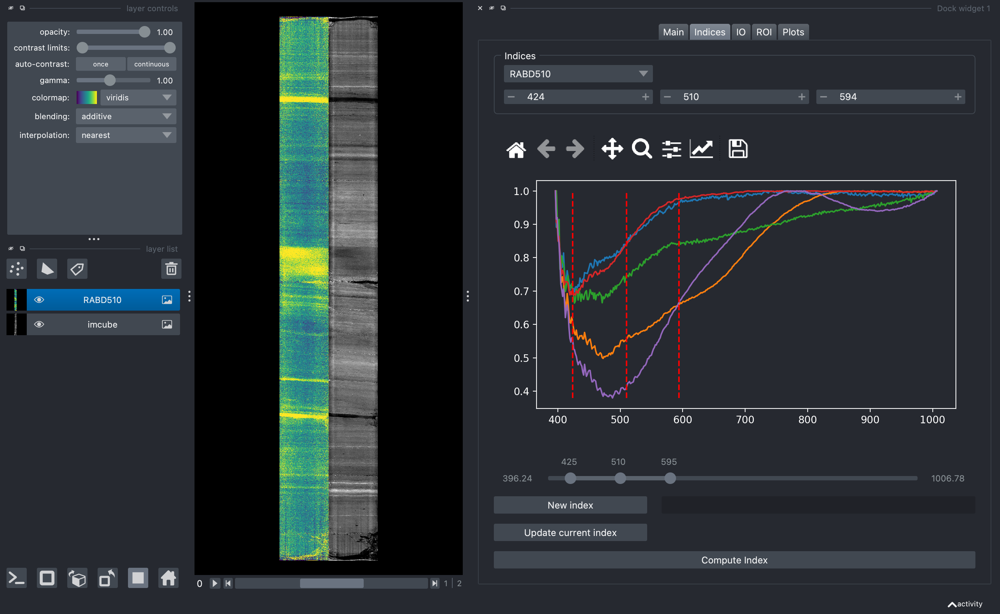

Traceback (most recent call last):
  File "/Users/gw18g940/GoogleDrive/BernMIC/Projects/Spectral/napari-sediment/src/napari_sediment/spectral_indices_widget.py", line 382, in create_index_plot
    newlabels = scale * np.array(tickpos)
TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'


In [32]:
nbscreenshot(viewer)